In [55]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Loading the data
X_train = pd.read_csv('data/single_turbine_data/X_train.csv')
X_test = pd.read_csv('data/single_turbine_data/X_test.csv')
y_train = pd.read_csv('data/single_turbine_data/y_train.csv')
y_test = pd.read_csv('data/single_turbine_data/y_test.csv')

# # remove the 1_ from the column names and save again
# X_train.columns = X_train.columns.str.replace('1_', '')
# X_test.columns = X_test.columns.str.replace('1_', '')
# y_train.columns = y_train.columns.str.replace('1_', '')
# y_test.columns = y_test.columns.str.replace('1_', '')

# # save
# X_train.to_csv('data/single_turbine_data/X_train.csv', index=False)
# X_test.to_csv('data/single_turbine_data/X_test.csv', index=False)
# y_train.to_csv('data/single_turbine_data/y_train.csv', index=False)
# y_test.to_csv('data/single_turbine_data/y_test.csv', index=False)

# convert to datetime
X_train['# Date and time'] = pd.to_datetime(X_train['# Date and time'])
X_test['# Date and time'] = pd.to_datetime(X_test['# Date and time'])
y_train['# Date and time'] = pd.to_datetime(y_train['# Date and time'])
y_test['# Date and time'] = pd.to_datetime(y_test['# Date and time'])

# Setting the index
# X_train.set_index('# Date and time', inplace=True)
# X_test.set_index('# Date and time', inplace=True)
# y_train.set_index('# Date and time', inplace=True)
# y_test.set_index('# Date and time', inplace=True)

# Merging X and y
train = pd.merge(X_train, y_train, on='# Date and time')
test = pd.merge(X_test, y_test, on='# Date and time')


In [56]:
train.isnull().sum()

# Date and time                              0
Wind speed (m/s)                             0
Wind direction (°)                           0
Nacelle position (°)                         0
Power (kW)                                   0
Reactive power (kvar)                        0
Front bearing temperature (°C)               0
Rear bearing temperature (°C)                0
Stator temperature 1 (°C)                    0
Nacelle ambient temperature (°C)             0
Nacelle temperature (°C)                     0
Transformer temperature (°C)                 0
Generator bearing rear temperature (°C)      0
Generator bearing front temperature (°C)     0
Temp. top box (°C)                           0
Hub temperature (°C)                         0
Ambient temperature (converter) (°C)         0
Rotor bearing temp (°C)                      0
Transformer cell temperature (°C)            0
Voltage L1 / U (V)                           0
Voltage L2 / V (V)                           0
Voltage L3 / 

Text(0, 0.5, 'Rotor Speed (RPM)')

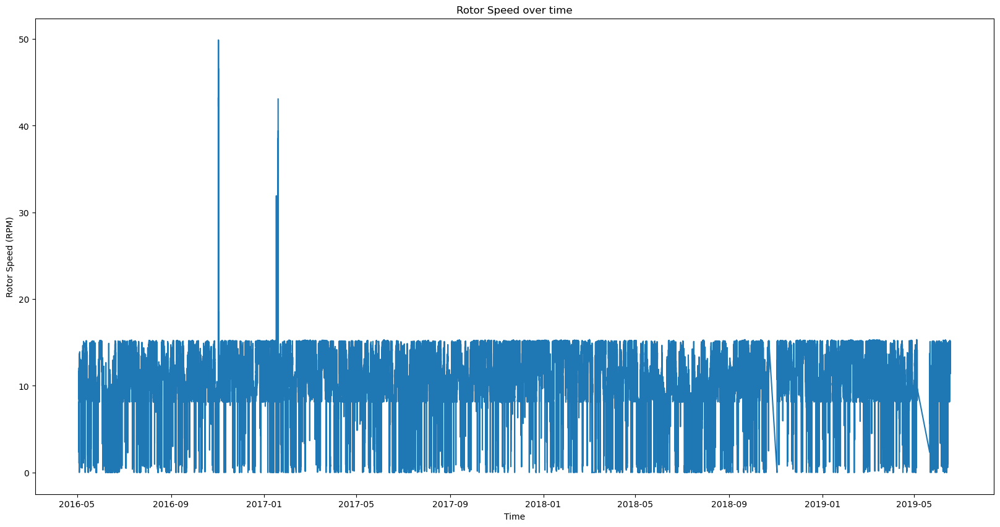

In [57]:
# plot rotor speed over time
plt.figure(figsize=(20, 10))
plt.plot(train['# Date and time'], train['Rotor speed (RPM)'])
plt.title('Rotor Speed over time')
plt.xlabel('Time')
plt.ylabel('Rotor Speed (RPM)')

In [58]:
# drop rotor speed
train.drop('Rotor speed (RPM)', axis=1, inplace=True)
test.drop('Rotor speed (RPM)', axis=1, inplace=True)

# drop columns containing voltage or pitch
train.drop(columns=[col for col in train.columns if 'Voltage' in col or 'pitch' in col], inplace=True)
test.drop(columns=[col for col in test.columns if 'Voltage' in col or 'pitch' in col], inplace=True)

# drop columns
train.drop(columns=['Current L1 / U (A)', 'Current L2 / V (A)', 'Current L3 / W (A)', 'Apparent power (kVA)'], inplace=True)
test.drop(columns=['Current L1 / U (A)', 'Current L2 / V (A)', 'Current L3 / W (A)', 'Apparent power (kVA)'], inplace=True)

train.drop(columns=['Gearbox speed (RPM)'], inplace=True)
test.drop(columns=['Gearbox speed (RPM)'], inplace=True)

train.drop(columns=['Yaw bearing angle (°)'], inplace=True)
test.drop(columns=['Yaw bearing angle (°)'], inplace=True)

train.drop(columns=['Reactive power (kvar)'], inplace=True)
test.drop(columns=['Reactive power (kvar)'], inplace=True)

In [59]:
# ffill the missing values
train.fillna(method='ffill', inplace=True)
test.fillna(method='ffill', inplace=True)

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_82270/2980455907.py:6: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_train = train.corr()
/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_82270/2980455907.py:7: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_test = test.corr()


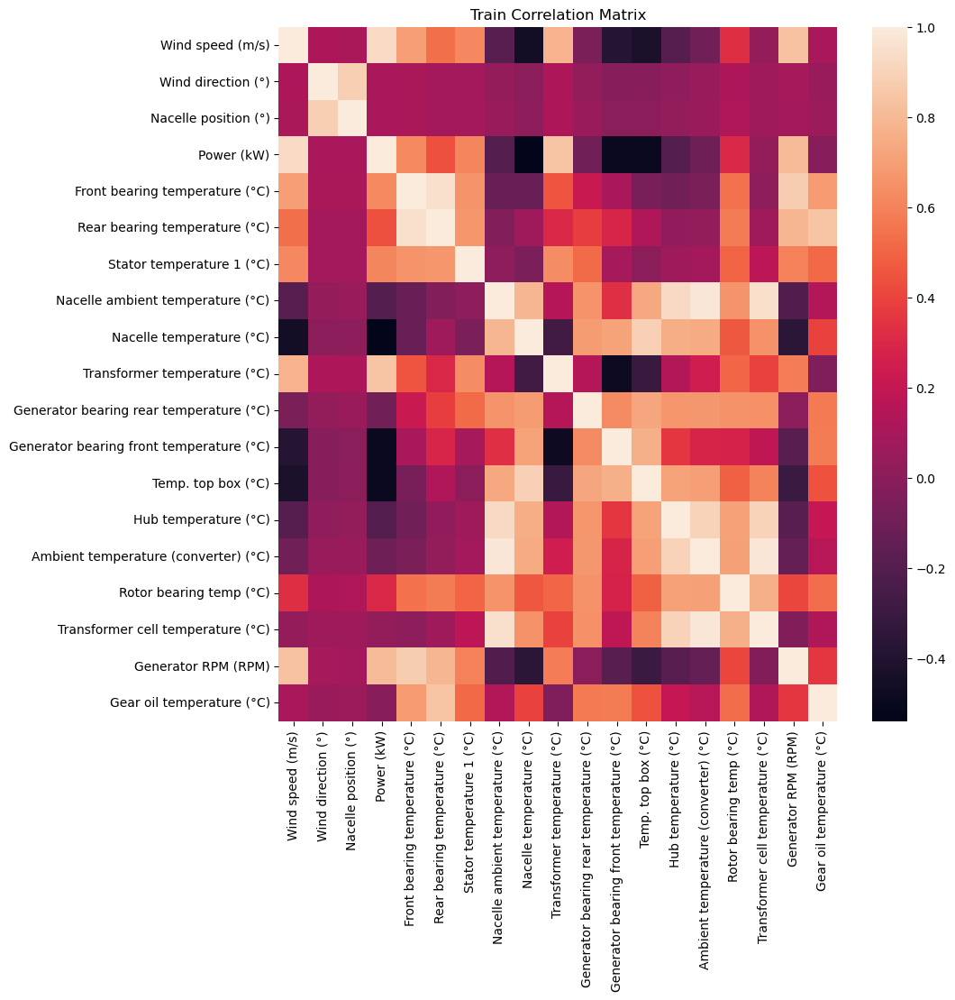

In [60]:
# Descriptive statistics
# display(train[['Front bearing temperature (°C)', 'Blade angle (pitch position) A (°)']].describe())
# display(test[['Front bearing temperature (°C)', 'Blade angle (pitch position) A (°)']].describe())

# Correlation analysis
corr_train = train.corr()
corr_test = test.corr()

# Heatmap of correlation matrix
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(corr_train, ax=ax)
plt.title('Train Correlation Matrix')
plt.show()

It looks like we have a strong correlation between some temperatures and also the pitch angles. Nacelle temperature does not correlate well, likely due to the fan cooling the nacelle.

The currents all correlate with one another and wind wind speed. Combine currents into one.

Rotor/gen/gbx speeds also correlates with current and wind speed but likely not as well due to downtimes. These then may contain useful downtime information. Could do 'if speed < value then generating = 0 else 1'.

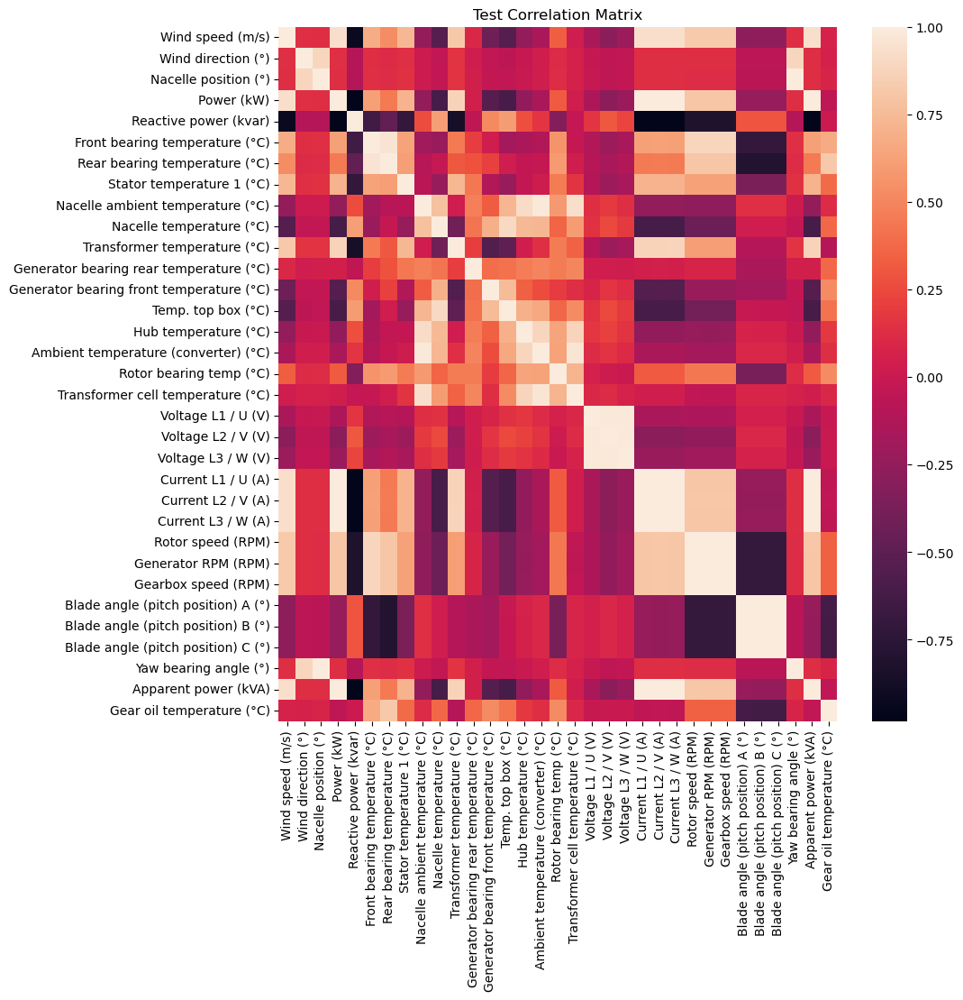

In [53]:
fig, ax = plt.subplots(figsize=(10,10))
sns.heatmap(corr_test, ax=ax)
plt.title('Test Correlation Matrix')
plt.show()

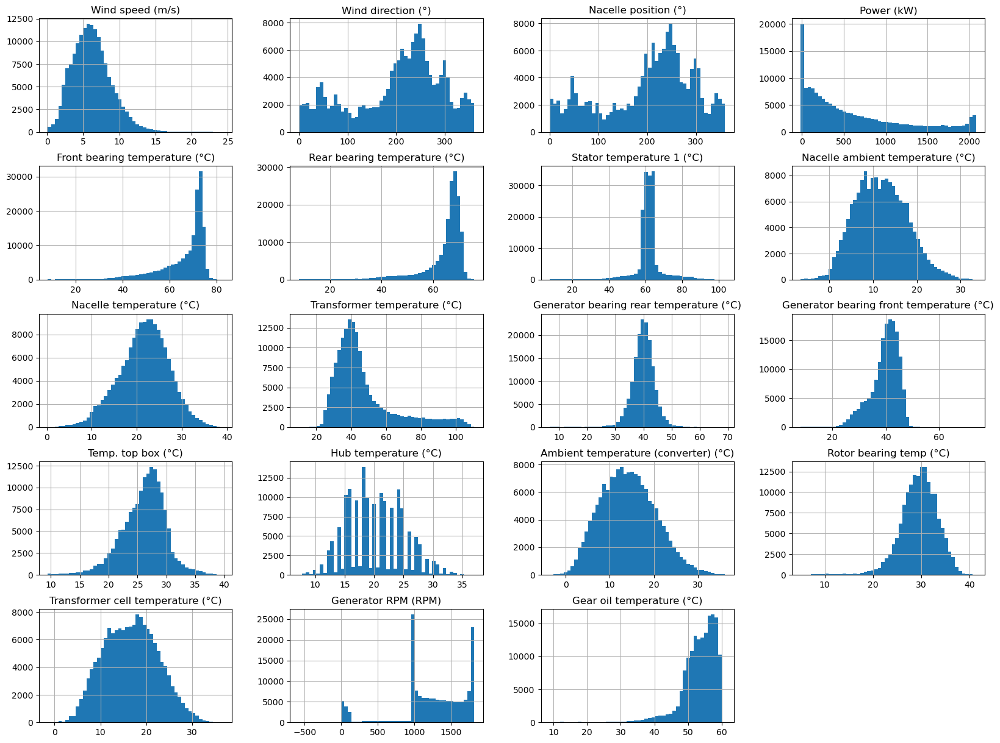

In [62]:
# Histograms for all variables in the dataframe except the date and time
train.drop('# Date and time', axis=1).hist(bins=50, figsize=(20, 15))
plt.show()

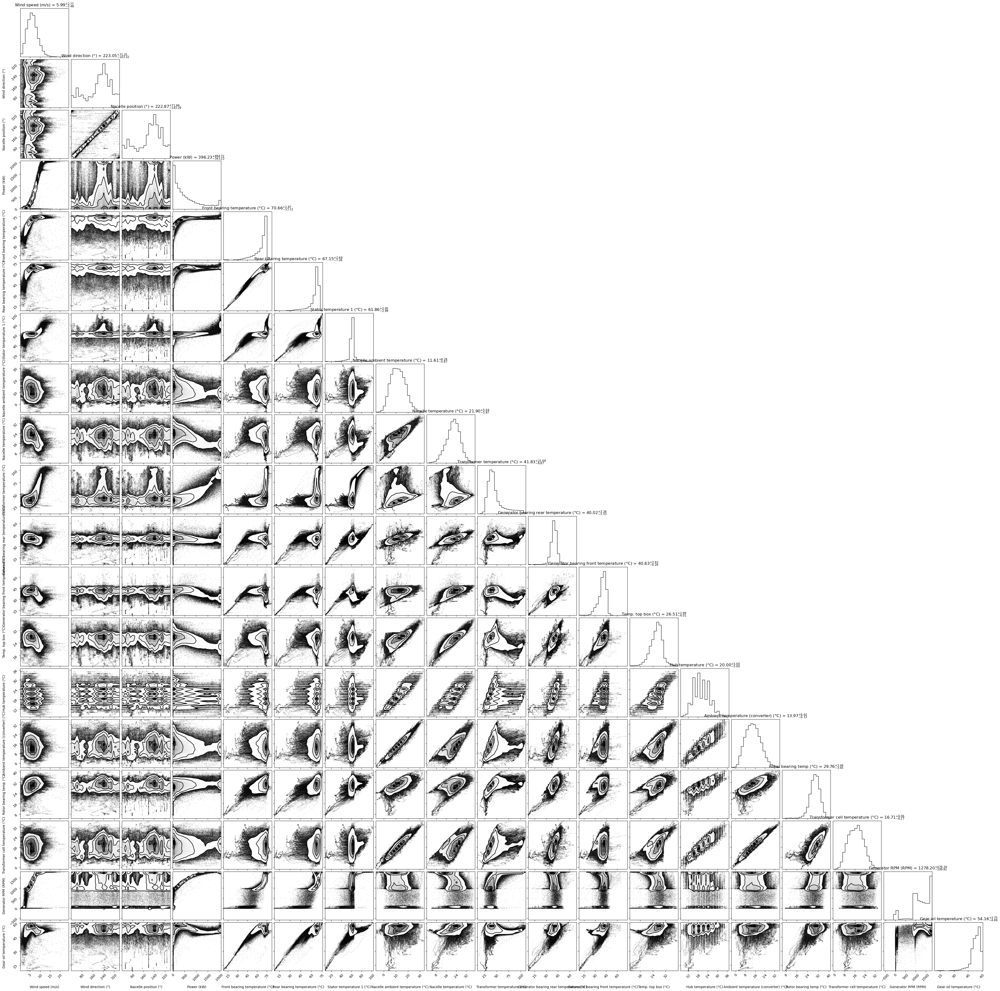

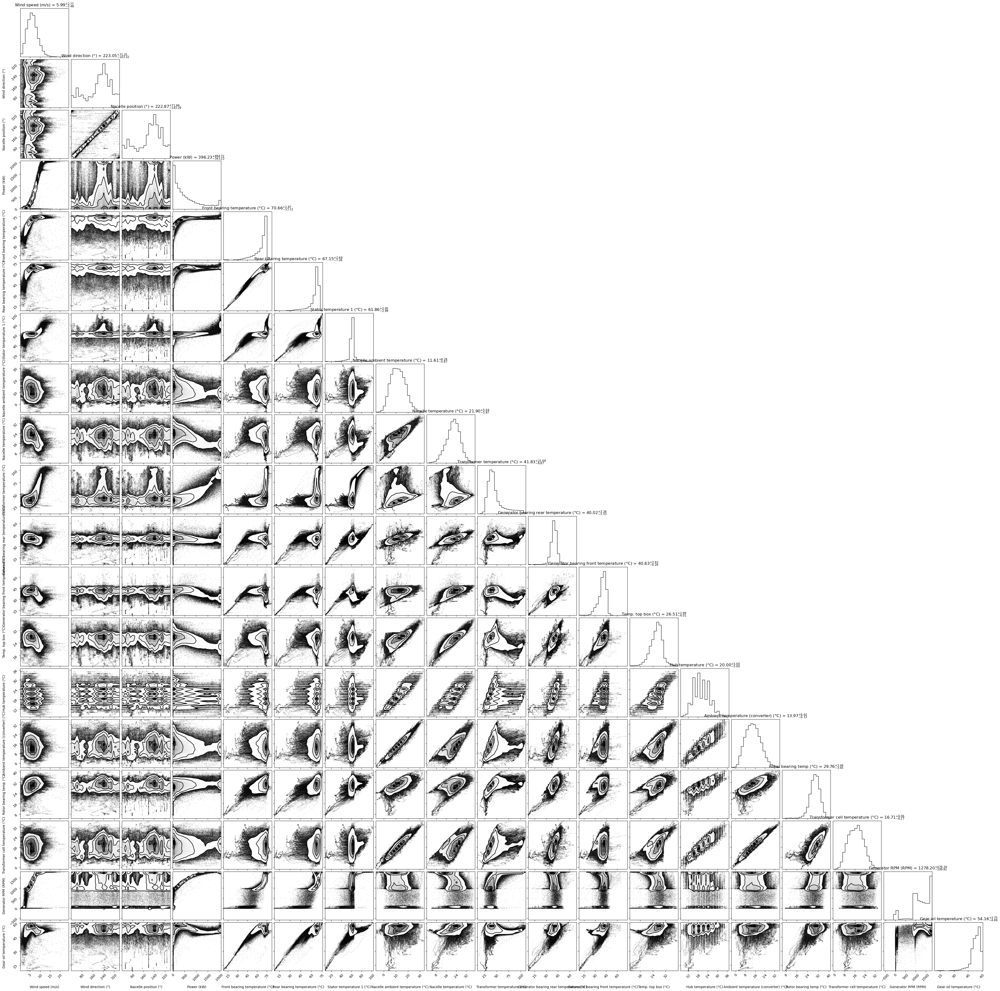

In [12]:
import corner

columns = [col for col in train.columns if col not in ['# Date and time']]

corner.corner(train[columns], labels=columns, show_titles=True, title_kwargs={"fontsize": 12})

We will want to drop everything in the zero active power bin. Or if we include it we may just need a bigger bodel.

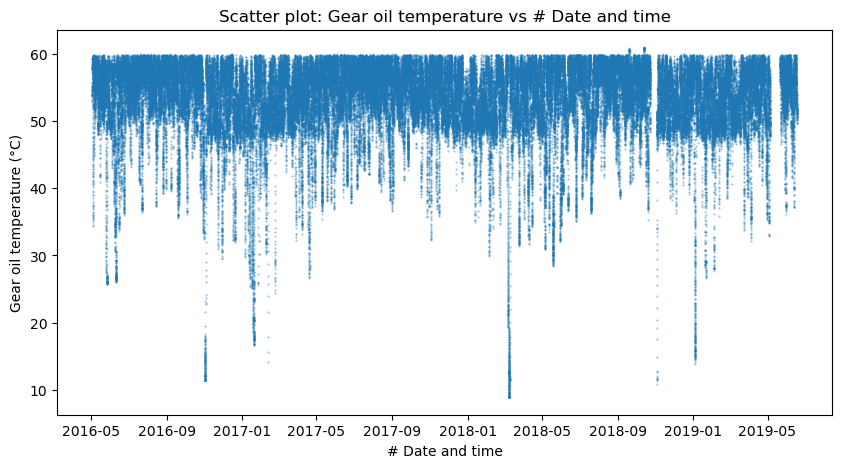

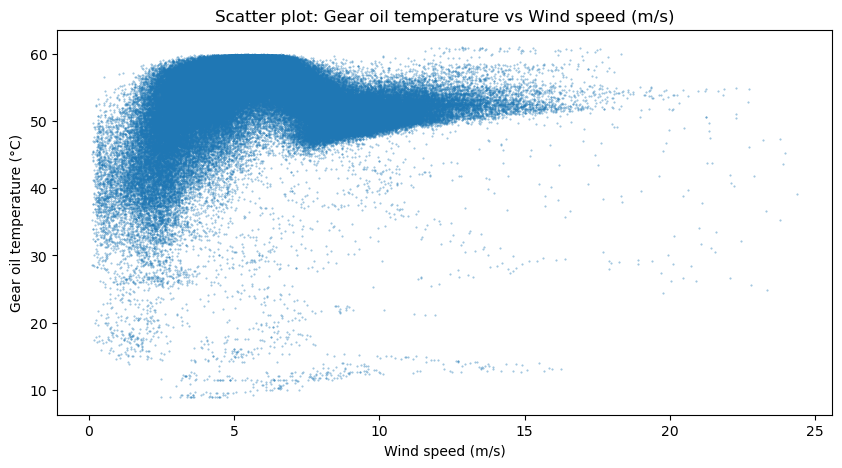

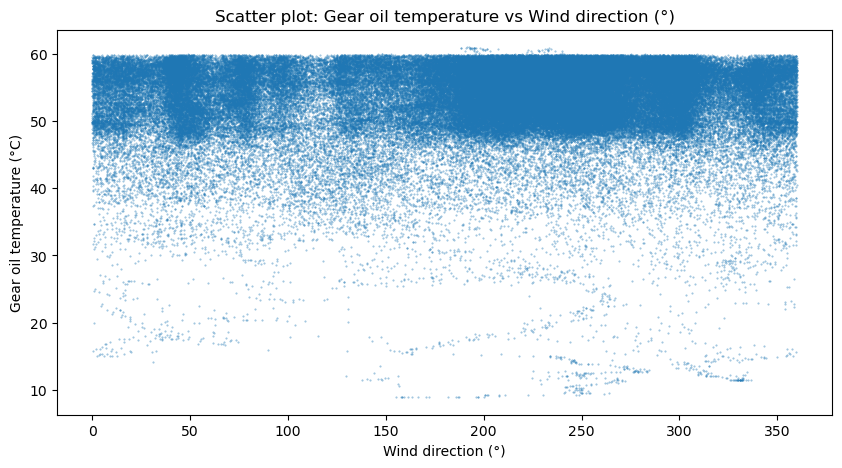

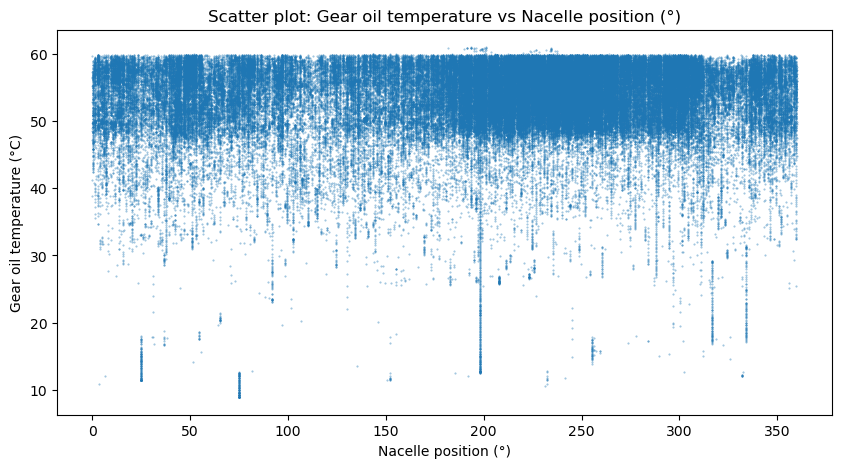

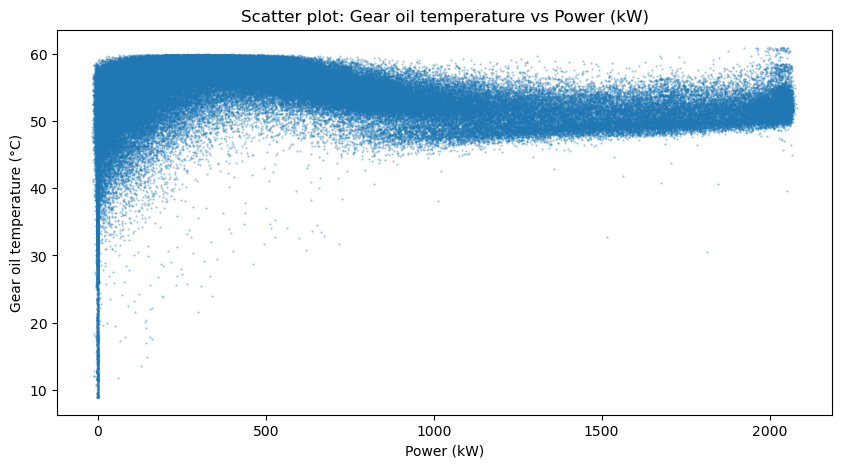

...

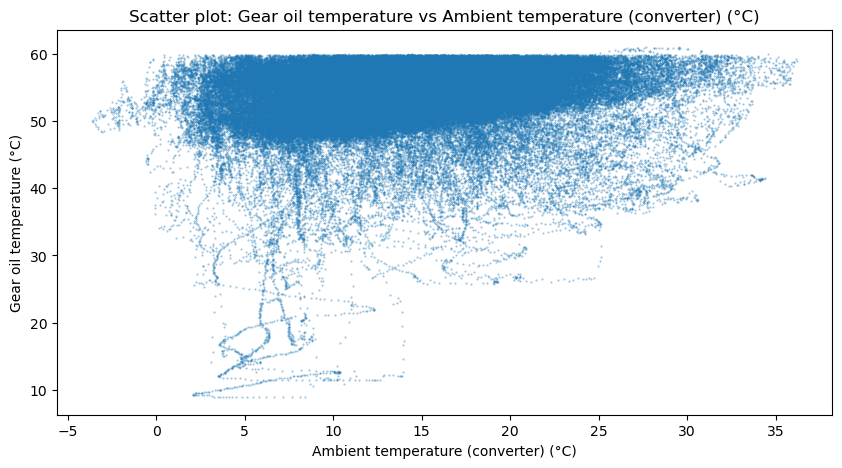

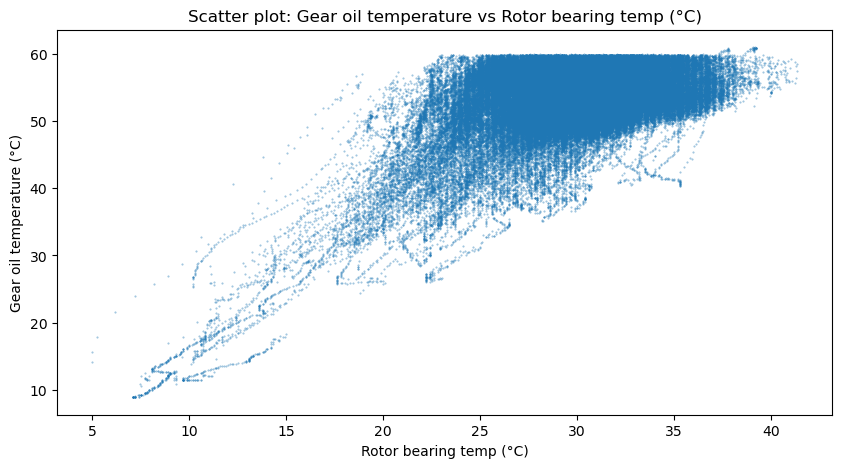

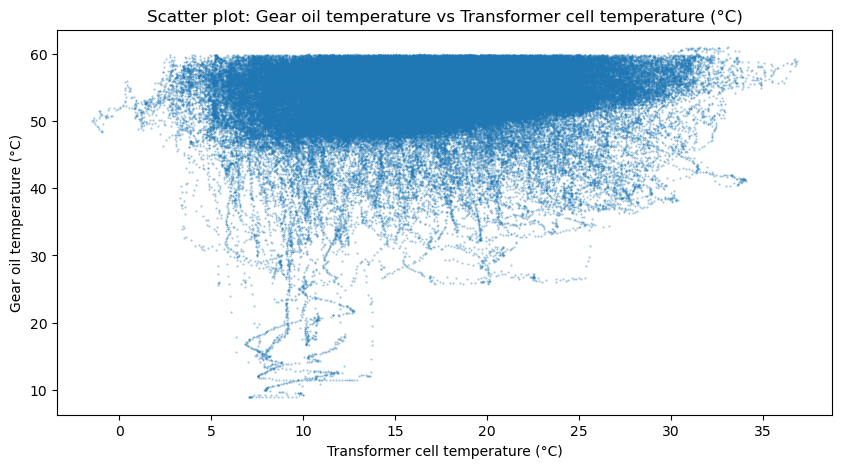

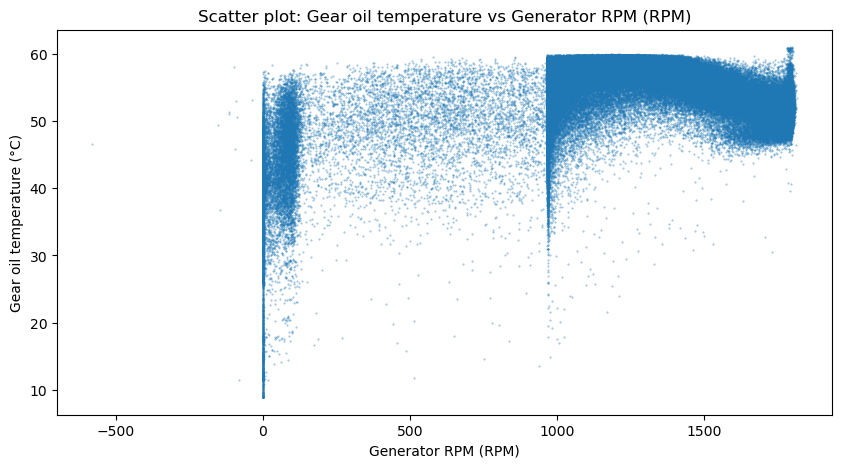

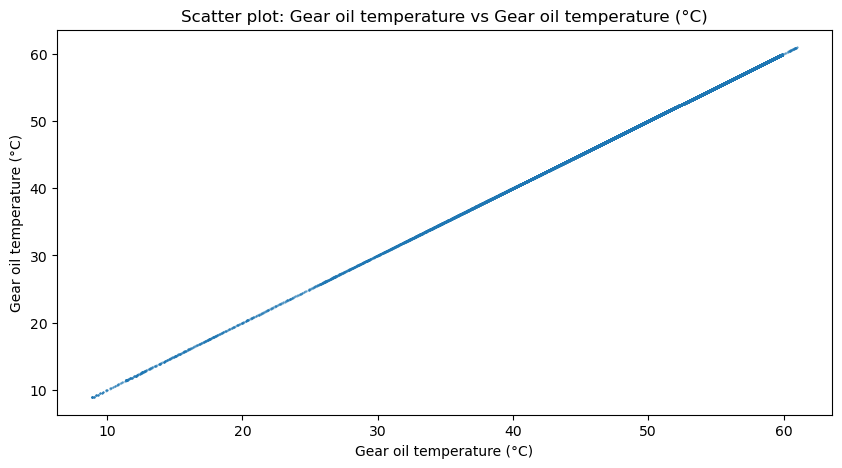

In [15]:
# Scatter plots of the target variable with respect to all other variables
for col in train.columns:
    train.plot(kind='scatter', x=col, y='Gear oil temperature (°C)', alpha=0.5, s=0.2)
    plt.title(f'Scatter plot: Gear oil temperature vs {col}')
    # update width
    plt.gcf().set_size_inches(10, 5)
    plt.show()

In [16]:
train['curtailed'] = (train['Wind speed (m/s)'] >= 11) & ((train['Generator RPM (RPM)'] >= 850) & (train['Generator RPM (RPM)'] <= 1100))
test['curtailed'] = (test['Wind speed (m/s)'] >= 11) & ((test['Generator RPM (RPM)'] >= 850) & (test['Generator RPM (RPM)'] <= 1100))

In [17]:
# train['offline'] = (train['Wind speed (m/s)'] >= 5) & (train['Generator RPM (RPM)'] <= 800)
# test['offline'] = (test['Wind speed (m/s)'] >= 5) & (test['Generator RPM (RPM)'] <= 800)
train['offline'] = train['Power (kW)'] <= 100
test['offline'] = test['Power (kW)'] <= 100

In [18]:
# drop 'Wind speed (m/s)'
train.drop(['Wind speed (m/s)'], axis=1, inplace=True)
test.drop(['Wind speed (m/s)'], axis=1, inplace=True)

/Users/johnny/anaconda3/envs/hacakthon/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/johnny/anaconda3/envs/hacakthon/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


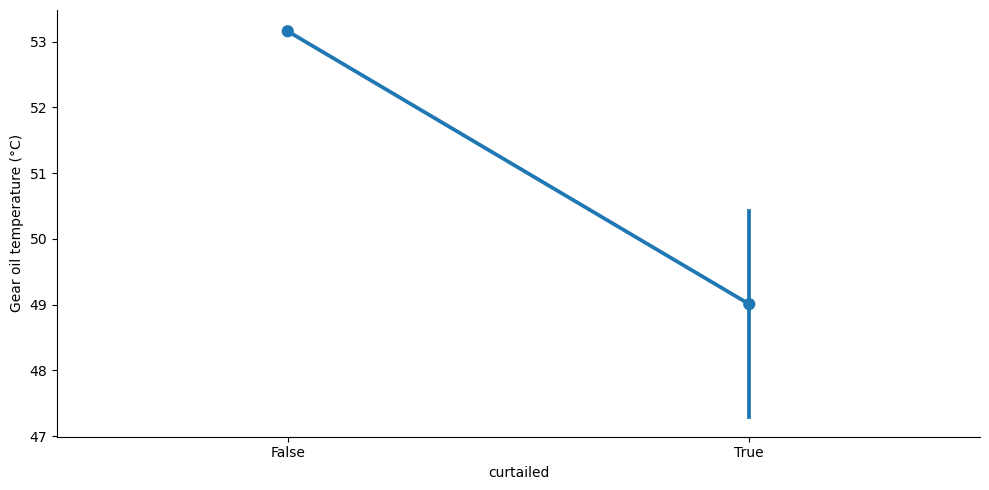

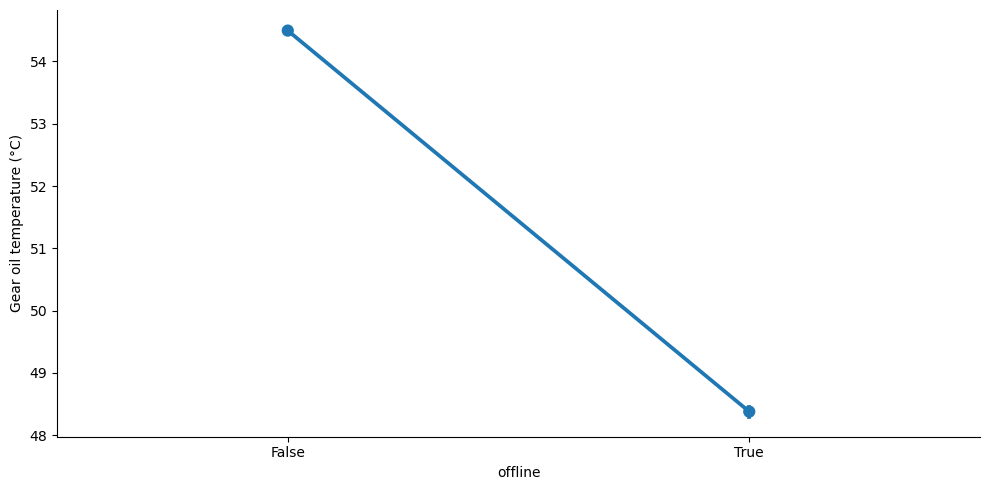

In [19]:
# Generate categorical plots for features
for col in ['curtailed', 'offline']:
    sns.catplot(x=col, y='Gear oil temperature (°C)', data=train, kind='point', aspect=2, )

In [508]:
def detect_outlier(feature):
    data = train[feature]
    mean = np.mean(data)
    std = np.std(data)

    z_scores = np.abs((data - mean) / std)
    outliers = data[z_scores > 3]

    cap_95 = data.quantile(.95)
    cap_99 = data.quantile(.99)
    cap_999 = data.quantile(.999)
    cap_3sd = mean + 3 * std
    cap_4sd = mean + 4 * std

    print('\nOutlier caps for {}:'.format(feature))
    print('  --95p: {:.1f} / {} values exceed that'.format(cap_95, (data > cap_95).sum()))
    print('  --3sd: {:.1f} / {} values exceed that'.format(cap_3sd, len(outliers)))
    print('  --4sd: {:.1f} / {} values exceed that'.format(cap_4sd, (data > cap_4sd).sum()))
    print('  --99p: {:.1f} / {} values exceed that'.format(cap_99, (data > cap_99).sum()))
    print('  --99.9p: {:.1f} / {} values exceed that'.format(cap_999, (data > cap_999).sum()))

In [509]:
import numpy as np

# Determine what the upperbound should be for continuous features
non_bool_feats = train.dtypes[train.dtypes != "bool"].index

for feat in non_bool_feats:
    detect_outlier(feat)


Outlier caps for # Date and time:
  --95p: .1f / 7937 values exceed that
  --3sd: .1f / 0 values exceed that
  --4sd: .1f / 0 values exceed that
  --99p: .1f / 1588 values exceed that
  --99.9p: .1f / 159 values exceed that

Outlier caps for 1_Wind direction (°):
  --95p: 337.1 / 7937 values exceed that
  --3sd: 480.3 / 0 values exceed that
  --4sd: 572.7 / 0 values exceed that
  --99p: 354.5 / 1588 values exceed that
  --99.9p: 359.4 / 159 values exceed that

Outlier caps for 1_Nacelle position (°):
  --95p: 336.4 / 7928 values exceed that
  --3sd: 480.5 / 0 values exceed that
  --4sd: 573.1 / 0 values exceed that
  --99p: 354.0 / 1539 values exceed that
  --99.9p: 359.5 / 146 values exceed that

Outlier caps for 1_Power (kW):
  --95p: 1936.1 / 7937 values exceed that
  --3sd: 2396.9 / 0 values exceed that
  --4sd: 2994.3 / 0 values exceed that
  --99p: 2051.3 / 1588 values exceed that
  --99.9p: 2064.8 / 159 values exceed that

Outlier caps for 1_Front bearing temperature (°C):
  --

In [510]:
feat = 'Generator bearing front temperature (°C)'
mean = train[feat].mean()
std = train[feat].std()

upper_limit = mean + 4*std

train[feat] = train[feat].clip(upper=upper_limit)

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_82270/3979082705.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train['Gear oil temperature (°C)'] , fit=norm);



 mu = 53.16 and sigma = 5.57



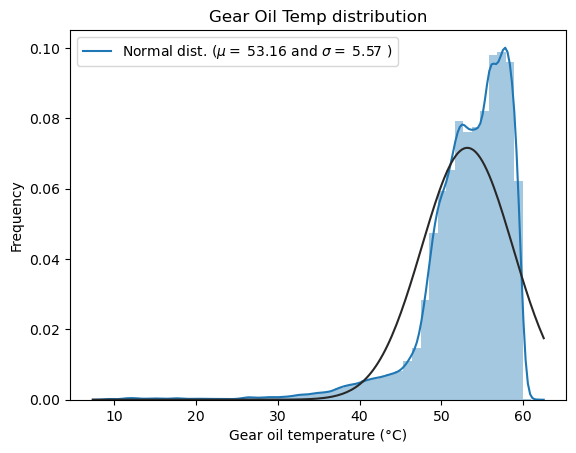

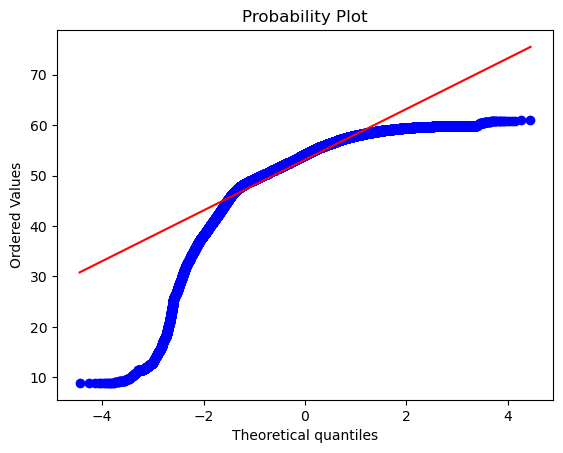

In [24]:
from scipy.stats import norm, skew
from scipy import stats

sns.distplot(train['Gear oil temperature (°C)'] , fit=norm);

# Get the fitted parameters used by the function
(mu, sigma) = norm.fit(train['Gear oil temperature (°C)'])
print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))

#Now plot the distribution
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')
plt.ylabel('Frequency')
plt.title('Gear Oil Temp distribution')

#Get also the QQ-plot
fig = plt.figure()
res = stats.probplot(train['Gear oil temperature (°C)'], plot=plt)
plt.show()

/Users/johnny/anaconda3/envs/hacakthon/lib/python3.10/site-packages/numpy/core/_methods.py:236: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
/Users/johnny/anaconda3/envs/hacakthon/lib/python3.10/site-packages/statsmodels/graphics/gofplots.py:910: RuntimeWarning: invalid value encountered in multiply
  ref_line = x * m + b


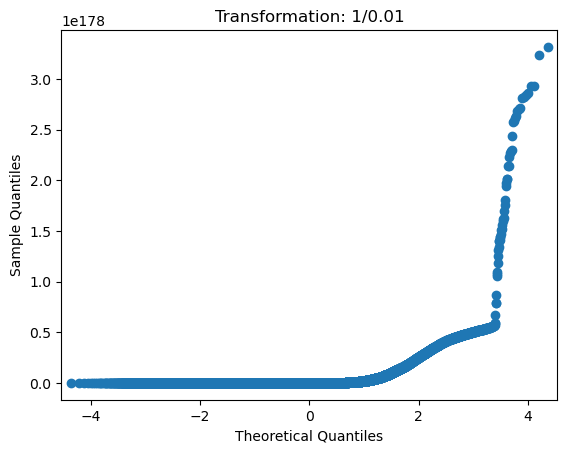

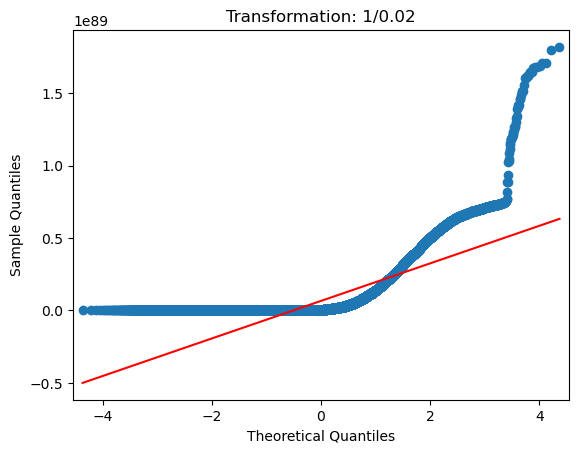

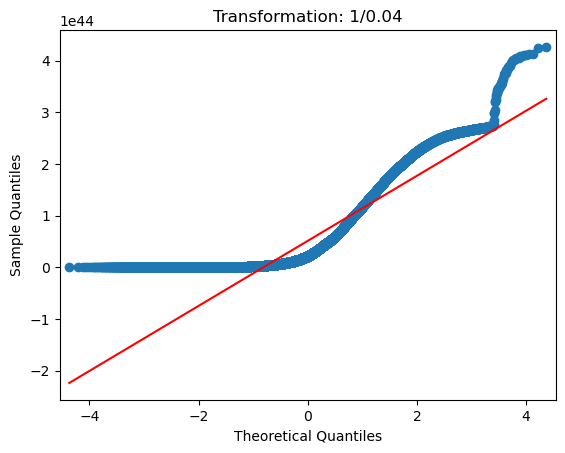

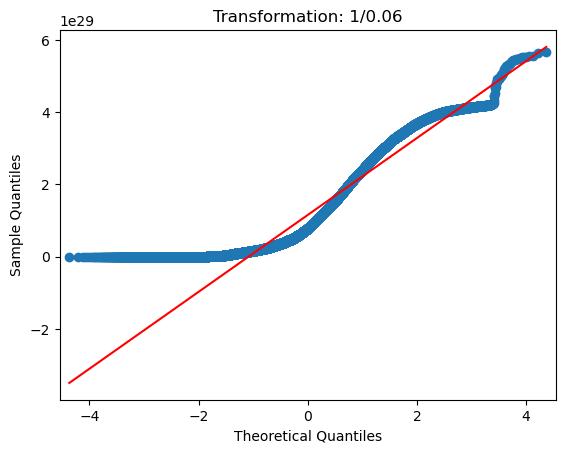

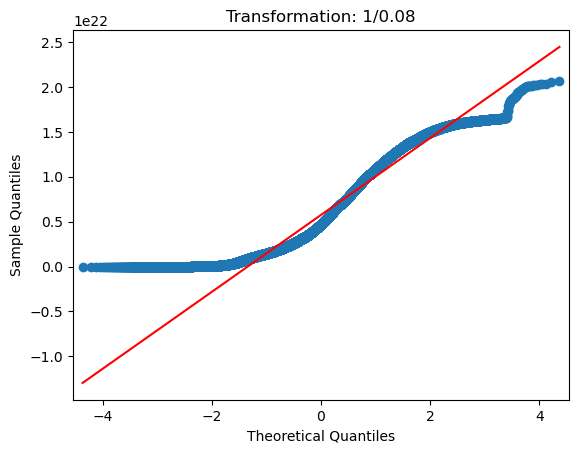

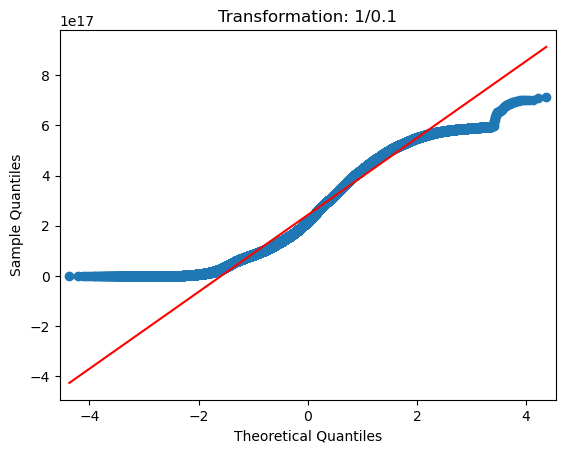

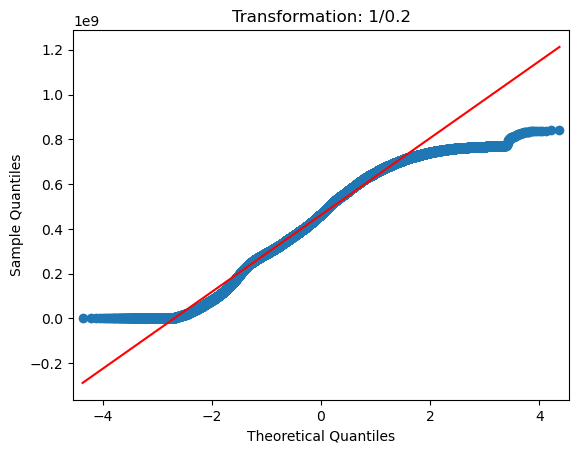

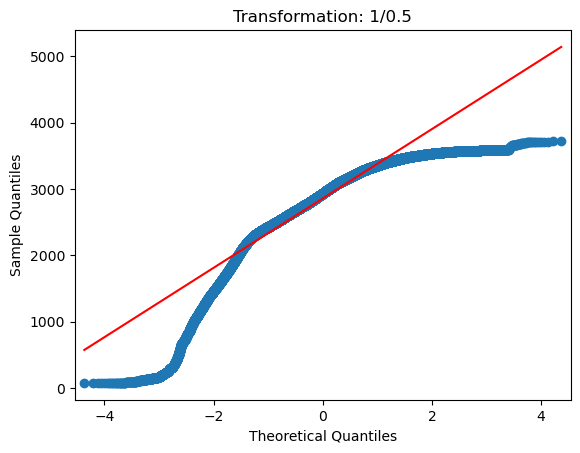

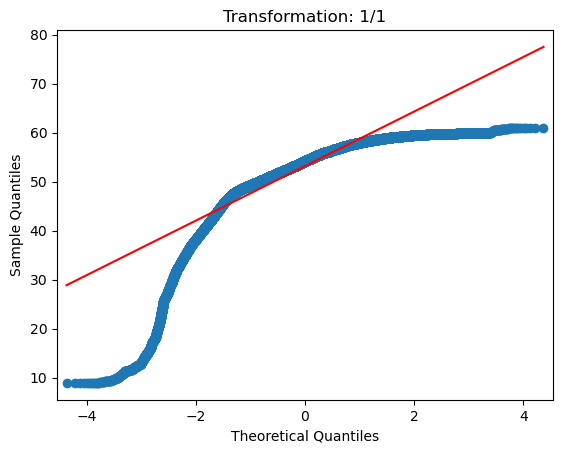

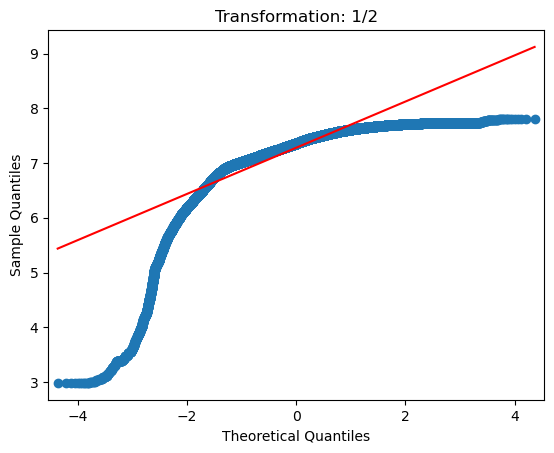

In [25]:
from statsmodels.graphics.gofplots import qqplot

# Generate QQ plots
for i in [0.01, 0.02, 0.04, 0.06, 0.08, 0.1, 0.2, 0.5, 1, 2]:
    data_t = train['Gear oil temperature (°C)']**(1/i)
    qqplot(data_t, line='s')
    plt.title("Transformation: 1/{}".format(str(i)))

In [513]:
# train['GearOilunsk'] = train['1_Gear oil temperature (°C)'].apply(lambda x: x**(1/0.06))
# test['GearOilunsk'] = test['1_Gear oil temperature (°C)'].apply(lambda x: x**(1/0.06))

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_82270/4082387196.py:18: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(transformed , fit=norm)



 For base 2.718281828459045, mu = 3.98 and sigma = 0.13



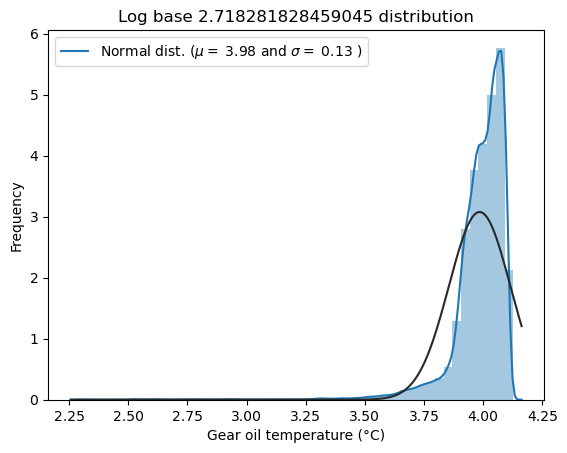

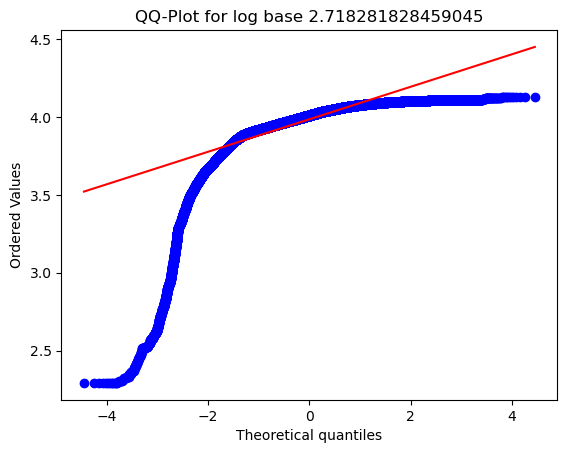

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_82270/4082387196.py:18: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(transformed , fit=norm)



 For base 2, mu = 5.75 and sigma = 0.19



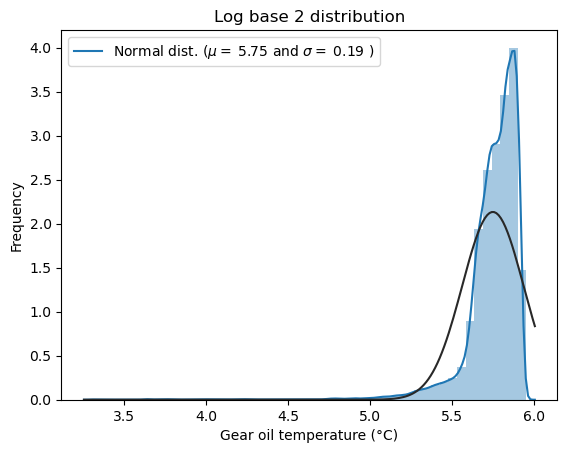

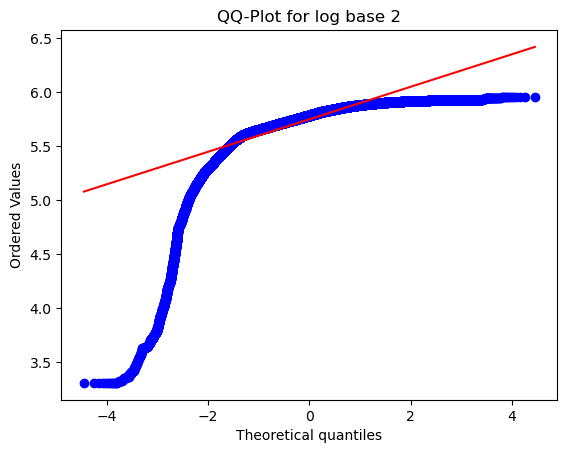

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_82270/4082387196.py:18: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(transformed , fit=norm)



 For base 10, mu = 1.73 and sigma = 0.06



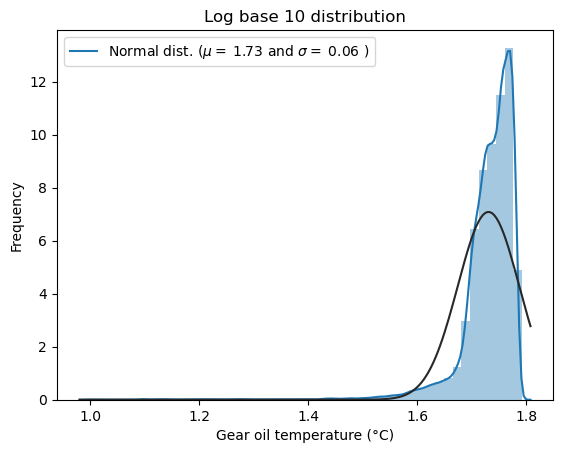

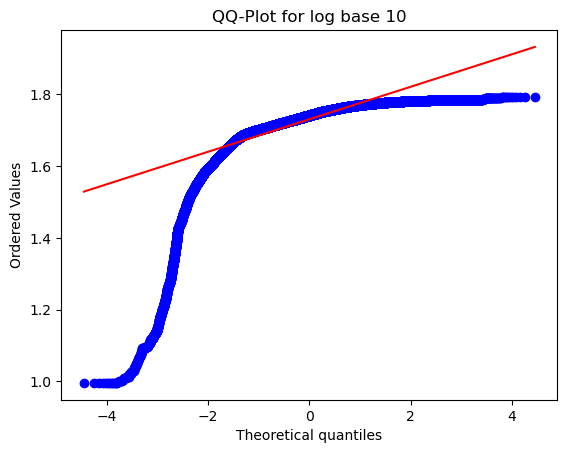

In [27]:
import matplotlib.pyplot as plt
from scipy.stats import norm, probplot
import seaborn as sns
import numpy as np

def log_transform(base, series):
    # Apply logarithm with specified base to all elements of the series
    return np.log1p(series) / np.log(base)

# List of logarithm bases to test
log_bases = [np.e, 2, 10]

# Iterate over the logarithm bases
for base in log_bases:
    transformed = log_transform(base, train["Gear oil temperature (°C)"])
    
    # Check the new distribution 
    sns.distplot(transformed , fit=norm)
    plt.title(f'Log base {base} distribution')
    
    # Get the fitted parameters used by the function
    (mu, sigma) = norm.fit(transformed)
    print(f'\n For base {base}, mu = {mu:.2f} and sigma = {sigma:.2f}\n')

    # Plot the distribution
    plt.legend([f'Normal dist. ($\mu=$ {mu:.2f} and $\sigma=$ {sigma:.2f} )'],
                loc='best')
    plt.ylabel('Frequency')
    plt.show()

    # Get also the QQ-plot
    fig = plt.figure()
    res = probplot(transformed, plot=plt)
    plt.title(f'QQ-Plot for log base {base}')
    plt.show()


In [28]:
train.dtypes

Wind direction (°)                          float64
Nacelle position (°)                        float64
Power (kW)                                  float64
Front bearing temperature (°C)              float64
Rear bearing temperature (°C)               float64
Stator temperature 1 (°C)                   float64
Nacelle ambient temperature (°C)            float64
Nacelle temperature (°C)                    float64
Transformer temperature (°C)                float64
Generator bearing rear temperature (°C)     float64
Generator bearing front temperature (°C)    float64
Temp. top box (°C)                          float64
Hub temperature (°C)                        float64
Ambient temperature (converter) (°C)        float64
Rotor bearing temp (°C)                     float64
Transformer cell temperature (°C)           float64
Generator RPM (RPM)                         float64
Gear oil temperature (°C)                   float64
curtailed                                      bool
offline     

In [29]:
# set the index
train.set_index('# Date and time', inplace=True)
test.set_index('# Date and time', inplace=True)

KeyError: "None of ['# Date and time'] are in the columns"

In [21]:
# train.drop(columns=['curtailed', 'offline', '1_Wind speed (m/s)'], inplace=True)
# test.drop(columns=['curtailed', 'offline', '1_Wind speed (m/s)'], inplace=True)

In [30]:
# For train DataFrame
for col in train.columns:
    if col not in ['curtailed', 'offline']:
        train.loc[train[col] <= 0, col] = 0.001

# For test DataFrame
for col in test.columns:
    if col not in ['curtailed', 'offline']:
        test.loc[test[col] <= 0, col] = 0.001

In [31]:
numeric_feats = train.dtypes[train.dtypes != "object"].index

# Check the skew of all numerical features
skewed_feats = train[numeric_feats].apply(lambda x: skew(x.dropna())).sort_values(ascending=False)
print("\nSkew in numerical features: \n")
skewness = pd.DataFrame({'Skew' :skewed_feats})
skewness.head(30)


Skew in numerical features: 



,Skew
curtailed,132.792236
Transformer temperature (°C),1.493109
offline,1.361136
Power (kW),1.023387
Nacelle ambient temperature (°C),0.286869
Ambient temperature (converter) (°C),0.284949
Hub temperature (°C),0.251949
Transformer cell temperature (°C),0.104164
Nacelle temperature (°C),-0.245885
Temp. top box (°C),-0.507465


In [32]:
numeric_feats_test = test.dtypes[test.dtypes != "object"].index

# Check the skew of all numerical features
skewed_feats_test = test[numeric_feats].apply(lambda x: skew(x.dropna())).sort_values(ascending=False)
print("\nSkew in numerical features: \n")
skewness_test = pd.DataFrame({'Skew' :skewed_feats})
skewness_test.head(30)


Skew in numerical features: 



,Skew
curtailed,132.792236
Transformer temperature (°C),1.493109
offline,1.361136
Power (kW),1.023387
Nacelle ambient temperature (°C),0.286869
Ambient temperature (converter) (°C),0.284949
Hub temperature (°C),0.251949
Transformer cell temperature (°C),0.104164
Nacelle temperature (°C),-0.245885
Temp. top box (°C),-0.507465


In [33]:
skewness = skewness[abs(skewness) > 1.1]
skewness = skewness.dropna()
print("There are {} skewed numerical features to Box Cox transform".format(skewness.shape[0]))

from scipy.special import boxcox1p
skewed_features = skewness.index
lam = 0.15
for feat in skewed_features:
    if feat not in ['Gear oil temperature (°C)', 'GearOilunsk','curtailed', 'offline']:
    #all_data[feat] += 1
        train[f'{feat}unsk'] = boxcox1p(train[feat], lam)

There are 8 skewed numerical features to Box Cox transform


In [34]:
skewness_test = skewness_test[abs(skewness_test) > 1.1]
skewness_test = skewness_test.dropna()
print("There are {} skewed numerical features to Box Cox transform".format(skewness_test.shape[0]))

from scipy.special import boxcox1p
skewed_features_test = skewness_test.index
lam = 0.15
for feat in skewed_features_test:
    if feat not in ['Gear oil temperature (°C)', 'GearOilunsk','curtailed', 'offline']:
    #all_data[feat] += 1
        test[f'{feat}unsk'] = boxcox1p(test[feat], lam)

There are 8 skewed numerical features to Box Cox transform


In [35]:
print(train.shape, test.shape)
train = pd.get_dummies(train)
test = pd.get_dummies(test)
print(train.shape, test.shape)

(158731, 25) (52206, 25)
(158731, 25) (52206, 25)


In [36]:
def seasonality_features(df):
    df['month_sin'] = np.sin(2*np.pi*df.index.month/12)
    df['month_cos'] = np.cos(2*np.pi*df.index.month/12)
    df['hour_sin'] = np.sin(2*np.pi*df.index.hour/24)
    df['hour_cos'] = np.cos(2*np.pi*df.index.hour/24)
    return df

train = seasonality_features(train)
test = seasonality_features(test)

In [37]:
# save the data
train.to_csv('data/single_turbine_data/train_reduced_unskewed.csv', index=True)
test.to_csv('data/single_turbine_data/test_reduced_unskewed.csv', index=True)

In [38]:
all_data = train.append(test, ignore_index=False)
all_data = all_data[all_data['Power (kW)']<100]
all_data = all_data[:50]

/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_82270/313919314.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_data = train.append(test, ignore_index=False)


KeyError: '1_Power (kW)'

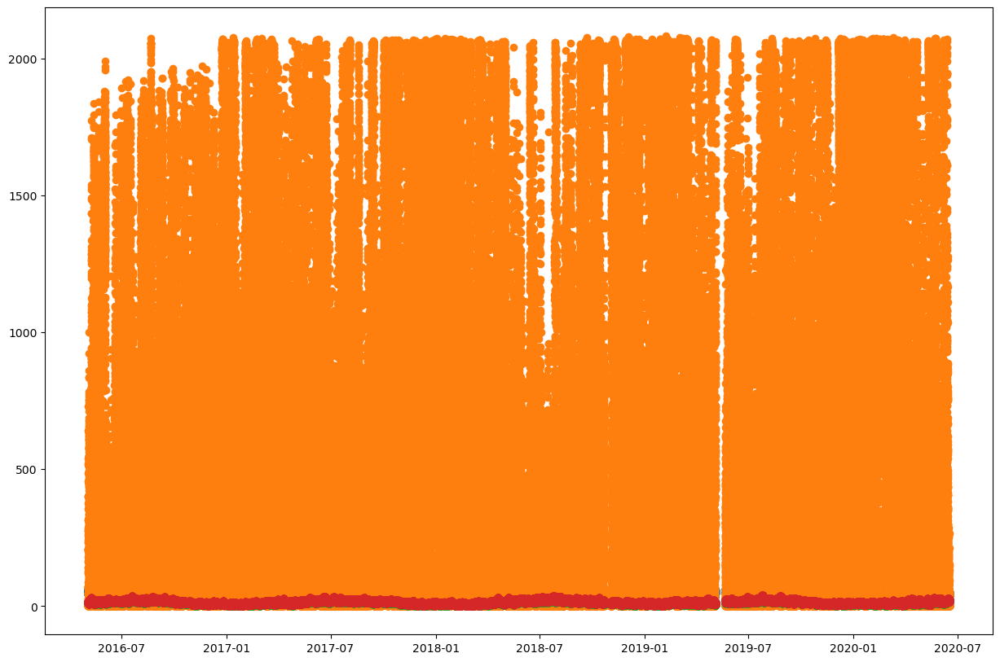

In [39]:
fig = plt.figure(figsize=(15, 10))

# plot the two time series
plt.scatter(all_data.index, all_data['Gear oil temperature (°C)'])
plt.scatter(all_data.index, all_data['Power (kW)'])
plt.scatter(all_data.index, all_data['Nacelle ambient temperature (°C)'])
plt.scatter(all_data.index, all_data['Ambient temperature (converter) (°C)'])

plt.show()

In [40]:
all_data.columns

Index(['Wind direction (°)', 'Nacelle position (°)', 'Power (kW)',
       'Front bearing temperature (°C)', 'Rear bearing temperature (°C)',
       'Stator temperature 1 (°C)', 'Nacelle ambient temperature (°C)',
       'Nacelle temperature (°C)', 'Transformer temperature (°C)',
       'Generator bearing rear temperature (°C)',
       'Generator bearing front temperature (°C)', 'Temp. top box (°C)',
       'Hub temperature (°C)', 'Ambient temperature (converter) (°C)',
       'Rotor bearing temp (°C)', 'Transformer cell temperature (°C)',
       'Generator RPM (RPM)', 'Gear oil temperature (°C)', 'curtailed',
       'offline', 'Transformer temperature (°C)unsk',
       'Generator bearing front temperature (°C)unsk',
       'Generator bearing rear temperature (°C)unsk',
       'Front bearing temperature (°C)unsk',
       'Rear bearing temperature (°C)unsk', 'month_sin', 'month_cos',
       'hour_sin', 'hour_cos'],
      dtype='object')

In [41]:
train.corr()['curtailed']

Wind direction (°)                              0.005296
Nacelle position (°)                            0.005206
Power (kW)                                      0.004001
Front bearing temperature (°C)                 -0.001537
Rear bearing temperature (°C)                  -0.005615
Stator temperature 1 (°C)                       0.019794
Nacelle ambient temperature (°C)               -0.003535
Nacelle temperature (°C)                       -0.007374
Transformer temperature (°C)                    0.018526
Generator bearing rear temperature (°C)         0.008037
Generator bearing front temperature (°C)       -0.008427
Temp. top box (°C)                             -0.009473
Hub temperature (°C)                           -0.005535
Ambient temperature (converter) (°C)           -0.001675
Rotor bearing temp (°C)                        -0.000895
Transformer cell temperature (°C)               0.001493
Generator RPM (RPM)                            -0.004166
Gear oil temperature (°C)      

<Axes: xlabel='Power (kW)', ylabel='Generator RPM (RPM)'>

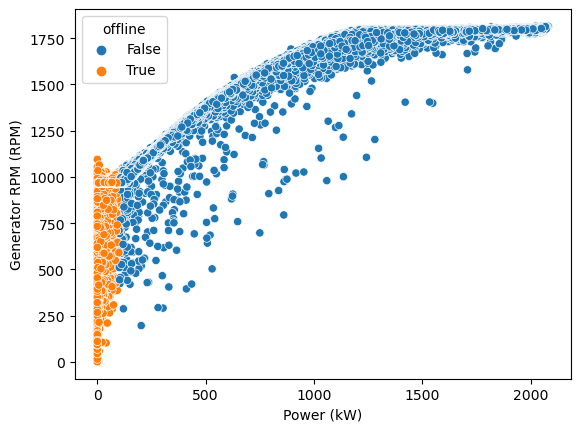

In [42]:
sns.scatterplot(data=train, x='Power (kW)', y='Generator RPM (RPM)', hue='offline')

In [43]:
all_data

,Wind direction (°),Nacelle position (°),Power (kW),Front bearing temperature (°C),Rear bearing temperature (°C),Stator temperature 1 (°C),Nacelle ambient temperature (°C),Nacelle temperature (°C),Transformer temperature (°C),Generator bearing rear temperature (°C),...,offline,Transformer temperature (°C)unsk,Generator bearing front temperature (°C)unsk,Generator bearing rear temperature (°C)unsk,Front bearing temperature (°C)unsk,Rear bearing temperature (°C)unsk,month_sin,month_cos,hour_sin,hour_cos
# Date and time,,,,,,,,,,,,,,,,,,,,,
2016-05-03 09:40:00,276.818054,268.365997,353.803345,72.366669,70.616669,64.250000,10.883333,20.616667,37.900002,41.533333,...,False,4.878526,5.159626,5.034203,6.031282,5.985382,5.000000e-01,-0.866025,0.707107,-0.707107
2016-05-03 09:50:00,275.881958,268.365997,515.468567,73.110001,71.254997,62.160000,10.945000,19.410000,37.919998,40.544998,...,False,4.879416,5.052962,4.993011,6.050497,6.002234,5.000000e-01,-0.866025,0.707107,-0.707107
2016-05-03 10:00:00,270.699310,268.365997,403.398895,69.065002,67.224998,59.150002,11.195000,19.049999,37.994999,39.044998,...,False,4.882751,4.914927,4.928873,5.943880,5.893641,5.000000e-01,-0.866025,0.500000,-0.866025
2016-05-03 10:10:00,278.005402,268.365997,399.778290,70.830002,69.139999,58.740002,11.765000,23.010000,38.035000,38.634998,...,False,4.884527,4.924090,4.910987,5.991028,5.945904,5.000000e-01,-0.866025,0.500000,-0.866025
2016-05-03 10:20:00,284.922363,268.365997,206.619904,68.900002,67.629997,59.174999,11.865000,24.450001,37.860001,39.119999,...,False,4.876744,4.980131,4.932128,5.939421,5.904797,5.000000e-01,-0.866025,0.500000,-0.866025
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-06-16 07:30:00,109.917045,77.390907,0.001000,38.709999,37.822500,47.852501,17.310000,25.309999,39.882500,38.142500,...,True,4.964931,4.956270,4.889293,4.914271,4.875073,1.224647e-16,-1.000000,0.965926,-0.258819
2020-06-16 07:40:00,119.556042,77.390907,0.001000,38.497500,37.485001,47.564999,17.395000,25.299999,39.980000,38.099998,...,True,4.969087,4.947358,4.887410,4.904954,4.859966,1.224647e-16,-1.000000,0.965926,-0.258819
2020-06-16 07:50:00,126.096721,77.390907,0.001000,38.305264,37.307894,47.231579,17.055263,25.107895,40.007895,38.094735,...,True,4.970275,4.937986,4.887177,4.896488,4.851994,1.224647e-16,-1.000000,0.965926,-0.258819


/var/folders/wh/srwjqw_j5gsbl1y7xdb9jc900000gn/T/ipykernel_20827/3118986722.py:1: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_data = train.append(test, ignore_index=False)


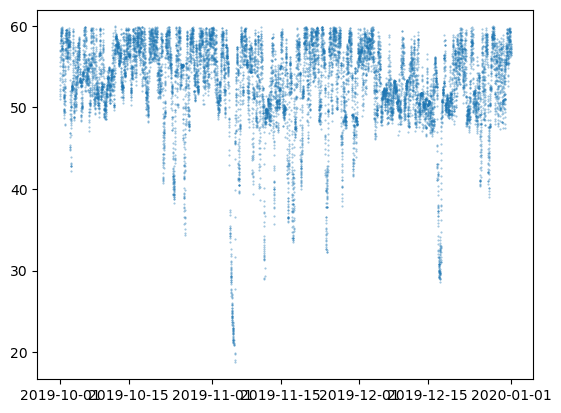

In [532]:
all_data = train.append(test, ignore_index=False)
event = all_data['2019-10-01':'2019-12-31']

plt.scatter(event.index, event['Gear oil temperature (°C)'], s=0.2, alpha=0.5)

In [46]:
import pandas as pd
from autogluon.tabular import TabularDataset, TabularPredictor
from sklearn.model_selection import train_test_split

train = pd.read_csv('data/single_turbine_data/train_reduced_unskewed.csv')
test = pd.read_csv('data/single_turbine_data/test_reduced_unskewed.csv')

label = ['Gear oil temperature (°C)']

# convert to datetime
train['# Date and time'] = pd.to_datetime(train['# Date and time'])

# Setting the index
train.set_index('# Date and time', inplace=True)

original_cols = ['Wind direction (°)',
       'Nacelle position (°)', 'Power (kW)',
       'Front bearing temperature (°C)', 'Rear bearing temperature (°C)',
       'Stator temperature 1 (°C)', 'Nacelle ambient temperature (°C)',
       'Nacelle temperature (°C)', 'Transformer temperature (°C)',
       'Generator bearing rear temperature (°C)',
       'Generator bearing front temperature (°C)', 'Temp. top box (°C)',
       'Hub temperature (°C)', 'Ambient temperature (converter) (°C)',
       'Rotor bearing temp (°C)', 'Transformer cell temperature (°C)', 'Generator RPM (RPM)']
          
train = train[original_cols + label]

In [47]:
# Lag by 1 to 6 steps and Lead by 1 to 6 steps
lag_dict = {}
lead_dict = {}

# Loop to create lagged and lead DataFrames for 1 to 6 steps
for i in range(1, 7):
    lag_df = train.copy()
    lag_df[label] = lag_df[label].shift(i)
    lag_df = lag_df.fillna(method='bfill')
    lag_df = lag_df.corr()
    lag_dict[f'lagged{i}'] = lag_df.loc[:, label]
    
    lead_df = train.copy()
    lead_df[label] = lead_df[label].shift(-i)
    lead_df = lead_df.fillna(method='ffill')
    lead_df = lead_df.corr()
    lead_dict[f'lead{i}'] = lead_df.loc[:, label]

# Original correlation
original = train.corr()
original_corr_with_label = original.loc[:, label]

# Concatenate all correlations into a single DataFrame
all_corr = pd.concat([original_corr_with_label] + list(lag_dict.values()) + list(lead_dict.values()), axis=1)
all_corr.columns = ['original'] + list(lag_dict.keys()) + list(lead_dict.keys())

best_lag_or_lead_dict = {}

for feature in all_corr.index:
    if feature != label[0]:  # skip the label itself
        best_corr_type = all_corr.loc[feature].idxmax()  # Gets the column name with max correlation
        
        # Translate column name to tuple (type, steps)
        if 'lagged' in best_corr_type:
            steps = int(best_corr_type.replace('lagged', ''))
            best_lag_or_lead_dict[feature] = ['lag', steps]
        elif 'lead' in best_corr_type:
            steps = int(best_corr_type.replace('lead', ''))
            best_lag_or_lead_dict[feature] = ['lead', steps]

print(best_lag_or_lead_dict)


{'Wind direction (°)': ['lead', 6], 'Nacelle position (°)': ['lead', 3], 'Power (kW)': ['lag', 6], 'Stator temperature 1 (°C)': ['lag', 1], 'Nacelle ambient temperature (°C)': ['lead', 6], 'Transformer temperature (°C)': ['lead', 6], 'Generator bearing rear temperature (°C)': ['lag', 1], 'Temp. top box (°C)': ['lag', 1], 'Hub temperature (°C)': ['lead', 6], 'Ambient temperature (converter) (°C)': ['lead', 6], 'Transformer cell temperature (°C)': ['lead', 6], 'Generator RPM (RPM)': ['lead', 6]}


In [48]:
all_corr

,original,lagged1,lagged2,lagged3,lagged4,lagged5,lagged6,lead1,lead2,lead3,lead4,lead5,lead6
Wind direction (°),0.051447,0.050988,0.050636,0.050317,0.049969,0.049411,0.049182,0.051968,0.052377,0.052658,0.052857,0.052898,0.052940
Nacelle position (°),0.060928,0.060844,0.060823,0.061017,0.061121,0.061221,0.061318,0.061403,0.061606,0.061650,0.061646,0.061433,0.061314
Power (kW),-0.016071,-0.013228,-0.011310,-0.009746,-0.008628,-0.007589,-0.006863,-0.027088,-0.024790,-0.021835,-0.019052,-0.015862,-0.012798
Front bearing temperature (°C),0.685337,0.669450,0.656394,0.647043,0.637364,0.627805,0.618060,0.677321,0.675945,0.676301,0.675242,0.673536,0.670951
Rear bearing temperature (°C),0.843274,0.822392,0.805134,0.792186,0.779048,0.766361,0.753648,0.832856,0.828725,0.826632,0.823055,0.819034,0.814242
Stator temperature 1 (°C),0.515677,0.520088,0.518518,0.514752,0.510034,0.504913,0.499491,0.507861,0.503459,0.499308,0.495527,0.491862,0.488210
Nacelle ambient temperature (°C),0.140482,0.139662,0.139088,0.138659,0.138311,0.137995,0.137680,0.141038,0.141537,0.142326,0.143208,0.144142,0.145134
Nacelle temperature (°C),0.397021,0.373253,0.358335,0.350246,0.343486,0.337544,0.331783,0.392175,0.386036,0.383789,0.380420,0.377137,0.373698
Transformer temperature (°C),-0.040964,-0.041770,-0.042174,-0.042232,-0.042012,-0.041582,-0.040971,-0.039197,-0.036609,-0.033878,-0.030997,-0.028062,-0.025103
Generator bearing rear temperature (°C),0.569479,0.571595,0.568266,0.563721,0.558759,0.553638,0.548322,0.563106,0.558346,0.553750,0.549137,0.544508,0.539875


In [49]:
train = pd.read_csv('data/single_turbine_data/train_reduced_unskewed.csv')
test = pd.read_csv('data/single_turbine_data/test_reduced_unskewed.csv')

# Initialize new DataFrames to store extra features
train_extra_features = pd.DataFrame(index=train.index)
test_extra_features = pd.DataFrame(index=test.index)

# Create the best extra features based on best_lag_or_lead_dict
for feature, (corr_type, steps) in best_lag_or_lead_dict.items():
    new_column_name = f"{feature}_{corr_type}{steps}"
    
    if corr_type == 'lag':
        train_extra_features[new_column_name] = train[feature].shift(steps)
        test_extra_features[new_column_name] = test[feature].shift(steps)
        train_extra_features[new_column_name] = train_extra_features[new_column_name].fillna(method='bfill')
        test_extra_features[new_column_name] = test_extra_features[new_column_name].fillna(method='bfill')
    elif corr_type == 'lead':
        train_extra_features[new_column_name] = train[feature].shift(-steps)
        test_extra_features[new_column_name] = test[feature].shift(-steps)
        train_extra_features[new_column_name] = train_extra_features[new_column_name].fillna(method='ffill')
        test_extra_features[new_column_name] = test_extra_features[new_column_name].fillna(method='ffill')

# Drop rows with NaN values generated due to shifting
# train_extra_features.dropna(inplace=True)
# test_extra_features.dropna(inplace=True)

# Optionally concatenate these extra features back to the original train and test DataFrames
train = pd.concat([train.loc[train_extra_features.index], train_extra_features], axis=1)
test = pd.concat([test.loc[test_extra_features.index], test_extra_features], axis=1)

# save the data
train.to_csv('data/single_turbine_data/train_reduced_unskewed_extra.csv', index=True)
test.to_csv('data/single_turbine_data/test_reduced_unskewed_extra.csv', index=True)

In [50]:
import pandas as pd

era = pd.read_csv('data/single_turbine_data_notemp/ERA5T.csv')
X_train = pd.read_csv('data/single_turbine_data_notemp/X_train.csv')
y_train = pd.read_csv('data/single_turbine_data_notemp/y_train.csv')
train = pd.merge(X_train, y_train, on='# Date and time')
train.set_index('# Date and time', inplace=True)
train.index = pd.to_datetime(train.index)
era['datetime_start_utc'] = pd.to_datetime(era['datetime_start_utc'])
era['datetime_start_utc'] = era['datetime_start_utc'].dt.tz_convert(None)
era.set_index('datetime_start_utc', inplace=True)
# merge era and train and interpolate the missing values
# Resample and interpolate the ERA5T dataframe
era = era.resample('10T').asfreq()
era = era.interpolate(method='linear')
train = pd.merge(train, era, left_on=train.index, right_on=era.index).set_index('key_0')

In [51]:
train.columns

import numpy as np

train['cos_wd'] = np.cos(2*np.pi*train['Wind direction (°)']/360)
train['cos_np'] = np.cos(2*np.pi*train['Nacelle position (°)']/360)
train['avg_dir'] = (train['cos_wd'] + train['cos_np'])/2

import matplotlib.pyplot as plt

# plt.scatter(train['cos_wd'], train['1_Gear oil temperature (°C)'], s=0.2, alpha=0.5)

def seasonality_features(df):
    df['month_sin'] = np.sin(2*np.pi*df.index.month/12)
    df['month_cos'] = np.cos(2*np.pi*df.index.month/12)*-1
    df['hour_sin'] = np.sin(2*np.pi*df.index.hour/24)
    df['hour_cos'] = np.cos(2*np.pi*df.index.hour/24)*-1
    return df

train = seasonality_features(train)

plt.plot(train.index[0:144], train['hour_cos'][0:144], color='black')
# tilt the ticks
plt.xticks(rotation=45)

train.index

KeyError: 'Wind direction (°)'

In [26]:
# merge era and train


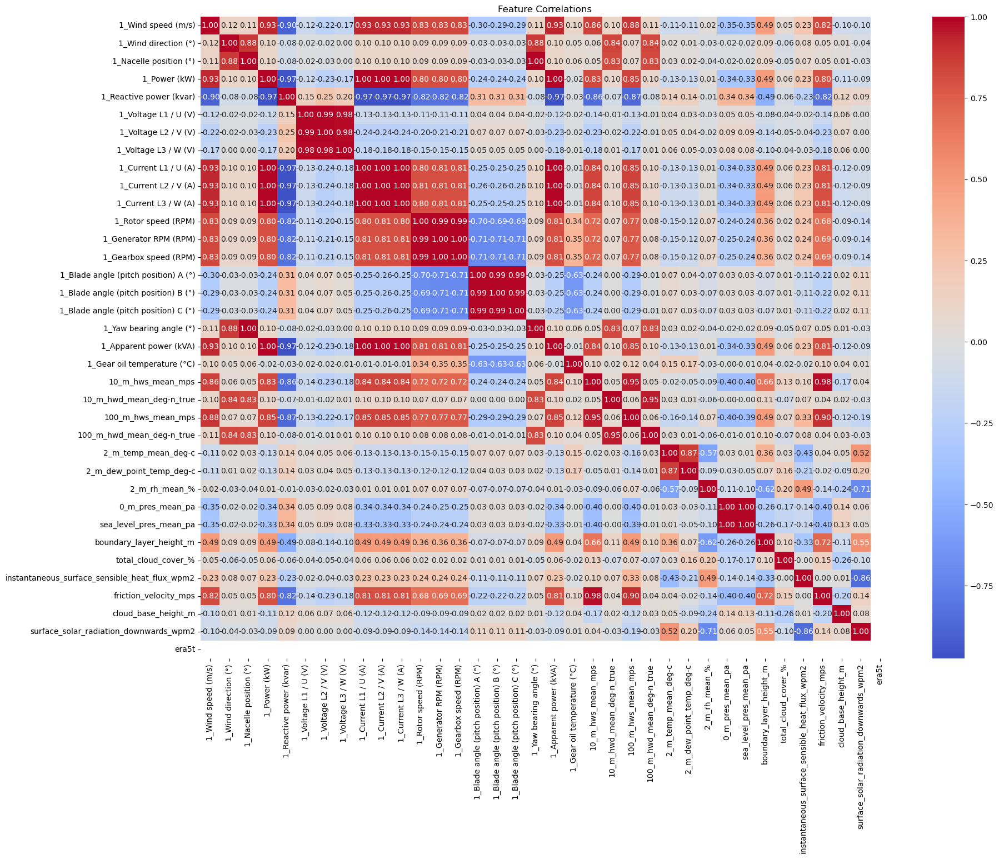

In [52]:
import matplotlib.pyplot as plt
import seaborn as sns

# Compute correlations

correlations = train.corr()

# Plot heatmap

plt.figure(figsize=(20, 15))

sns.heatmap(correlations, annot=True, fmt=".2f", cmap="coolwarm", center=0)

plt.title('Feature Correlations')

plt.show()

In [32]:
train.columns

Index(['key_0', '1_Wind speed (m/s)', '1_Wind direction (°)',
       '1_Nacelle position (°)', '1_Power (kW)', '1_Reactive power (kvar)',
       '1_Voltage L1 / U (V)', '1_Voltage L2 / V (V)', '1_Voltage L3 / W (V)',
       '1_Current L1 / U (A)', '1_Current L2 / V (A)', '1_Current L3 / W (A)',
       '1_Rotor speed (RPM)', '1_Generator RPM (RPM)', '1_Gearbox speed (RPM)',
       '1_Blade angle (pitch position) A (°)',
       '1_Blade angle (pitch position) B (°)',
       '1_Blade angle (pitch position) C (°)', '1_Yaw bearing angle (°)',
       '1_Apparent power (kVA)', '1_Gear oil temperature (°C)',
       '10_m_hws_mean_mps', '10_m_hwd_mean_deg-n_true', '100_m_hws_mean_mps',
       '100_m_hwd_mean_deg-n_true', '2_m_temp_mean_deg-c',
       '2_m_dew_point_temp_deg-c', '2_m_rh_mean_%', '0_m_pres_mean_pa',
       'sea_level_pres_mean_pa', 'boundary_layer_height_m',
       'total_cloud_cover_%', 'instantaneous_surface_sensible_heat_flux_wpm2',
       'friction_velocity_mps', 'cloud_base_